
                 E-COMMERCE DATA ANALYSIS USING SQL

This project involves a comprehensive analysis of Brazilian e-commerce data using SQL. 

The aim is to extract valuable insights from a rich dataset, which includes information about customer behavior, sales trends, product performance, and logistics. The analysis will help in understanding the dynamics of the Brazilian e-commerce market and provide actionable insights for stakeholders.

## Connecting to the database

The `sqlite3` library allows us to query the database using python:

In [1]:
import sqlite3

db_path = '/kaggle/input/e-commerce-dataset-by-olist-as-an-sqlite-database/olist.sqlite'
db_connection = sqlite3.connect(db_path)

<br>

In [ ]:
import pandas as pd

def view_table(table, limit):
    query = f"""
        SELECT *
        FROM {table}
        LIMIT {limit}
    """
    return pd.read_sql_query(query, db_connection)

# Number of orders


In [12]:
# Table orders, first 10 columns
pd.read_sql_query(f"""SELECT * FROM {'orders'} LIMIT {10}""", db_connection).iloc[:, :3]

,order_id,customer_id,order_status
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered


In [19]:
# Table orders, timestamp columns
pd.read_sql_query(f"""SELECT * FROM {'orders'} LIMIT {10}""", db_connection).iloc[:, 3:]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,delivered,2017-07-09 21:57:05,2017-07-09 22:10:13,2017-07-11 14:58:04,2017-07-26 10:57:55,2017-08-01 00:00:00
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,None,None,2017-05-09 00:00:00
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,delivered,2017-05-16 13:10:30,2017-05-16 13:22:11,2017-05-22 10:07:46,2017-05-26 12:55:51,2017-06-07 00:00:00
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,delivered,2017-01-23 18:29:09,2017-01-25 02:50:47,2017-01-26 14:16:31,2017-02-02 14:08:10,2017-03-06 00:00:00
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,delivered,2017-07-29 11:55:02,2017-07-29 12:05:32,2017-08-10 19:45:24,2017-08-16 17:14:30,2017-08-23 00:00:00


In [17]:
#count the number of daily orders

orders_per_day = """
SELECT
    DATE(order_purchase_timestamp) AS day,
    COUNT(*) AS order_count
FROM orders
GROUP BY day
"""

df = pd.read_sql_query(orders_per_day, db_connection)
df.head(15)

,day,order_count
0,2016-09-04,1
1,2016-09-05,1
2,2016-09-13,1
3,2016-09-15,1
4,2016-10-02,1
5,2016-10-03,8
6,2016-10-04,63
7,2016-10-05,47
8,2016-10-06,51
9,2016-10-07,46


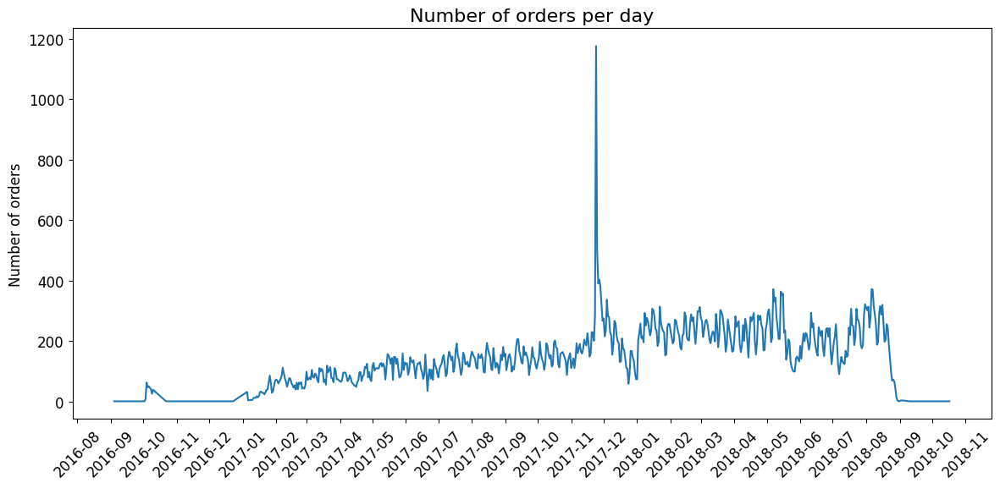

In [18]:
#Visualize frequency of orders per day

import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Increase the default font size globally
plt.rcParams['font.size'] = 12
plt.rcParams['axes.titlesize'] = 16

# Line plot
plt.figure(figsize=(14, 6))
plt.plot(pd.to_datetime(df['day']), df['order_count'])
plt.ylabel('Number of orders')
plt.title('Number of orders per day')
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.xticks(rotation=45)
plt.show()

There's a large spike of orders around Christmas. The number of orders also seems to be increasing steadily over time as Olist's business grows. 

In [20]:
#orders distrubuted over week

order_day_hour = """
SELECT
    -- Day of the week abreviated
    CASE STRFTIME('%w', order_purchase_timestamp)
        WHEN '1' THEN 'Mon'
        WHEN '2' THEN 'Tue'
        WHEN '3' THEN 'Wed'
        WHEN '4' THEN 'Thu'
        WHEN '5' THEN 'Fri'
        WHEN '6' THEN 'Sat'
        WHEN '0' THEN 'Sun'
        END AS day_of_week_name,
    -- Day of the week as integer (Sunday=7)
    CAST(STRFTIME('%w', order_purchase_timestamp) AS INTEGER) AS day_of_week_int,
    -- Hour of the day (0-24)
    CAST(STRFTIME("%H", order_purchase_timestamp) AS INTEGER) AS hour
FROM orders
"""

pd.read_sql_query(order_day_hour, db_connection)

,day_of_week_name,day_of_week_int,hour
0,Mon,1,10
1,Tue,2,20
2,Wed,3,8
3,Sat,6,19
4,Tue,2,21
...,...,...,...
99436,Thu,4,9
99437,Tue,2,12
99438,Sun,0,14
99439,Mon,1,21


In [22]:
count_orders_per_hour = ',\n    '.join([
    f'COUNT(CASE WHEN hour = {i} THEN 1 END) AS "{i}"' \
    for i in range(24)
])

orders_per_day_of_the_week_and_hour = f"""
WITH OrderDayHour AS (
    {order_day_hour}
)
SELECT
    day_of_week_name,
    {count_orders_per_hour}
FROM OrderDayHour
GROUP BY day_of_week_int
ORDER BY day_of_week_int
"""

In [26]:
print(orders_per_day_of_the_week_and_hour)


WITH OrderDayHour AS (
    
SELECT
    -- Day of the week abreviated
    CASE STRFTIME('%w', order_purchase_timestamp)
        WHEN '1' THEN 'Mon'
        WHEN '2' THEN 'Tue'
        WHEN '3' THEN 'Wed'
        WHEN '4' THEN 'Thu'
        WHEN '5' THEN 'Fri'
        WHEN '6' THEN 'Sat'
        WHEN '0' THEN 'Sun'
        END AS day_of_week_name,
    -- Day of the week as integer (Sunday=7)
    CAST(STRFTIME('%w', order_purchase_timestamp) AS INTEGER) AS day_of_week_int,
    -- Hour of the day (0-24)
    CAST(STRFTIME("%H", order_purchase_timestamp) AS INTEGER) AS hour
FROM orders

)
SELECT
    day_of_week_name,
    COUNT(CASE WHEN hour = 0 THEN 1 END) AS "0",
    COUNT(CASE WHEN hour = 1 THEN 1 END) AS "1",
    COUNT(CASE WHEN hour = 2 THEN 1 END) AS "2",
    COUNT(CASE WHEN hour = 3 THEN 1 END) AS "3",
    COUNT(CASE WHEN hour = 4 THEN 1 END) AS "4",
    COUNT(CASE WHEN hour = 5 THEN 1 END) AS "5",
    COUNT(CASE WHEN hour = 6 THEN 1 END) AS "6",
    COUNT(CASE WHEN hour = 7 THEN 1 E

In [27]:
df = pd.read_sql_query(orders_per_day_of_the_week_and_hour, db_connection)
df = df.set_index('day_of_week_name')
df

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
day_of_week_name,,,,,,,,,,,,,,,,,,,,,
Sun,267,141,69,44,27,27,34,105,205,349,...,684,716,712,797,895,899,967,889,873,607
Mon,328,134,66,36,21,22,69,160,479,783,...,1096,1079,1094,992,928,945,1027,1118,991,717
Tue,306,158,80,28,29,24,71,223,522,864,...,1124,1047,1081,967,877,924,988,1027,965,692
Wed,397,179,81,33,33,27,93,211,517,829,...,1050,983,1040,967,852,848,904,963,878,615
Thu,355,167,75,39,31,28,85,220,502,758,...,977,928,1077,909,784,826,839,840,857,551
Fri,426,216,72,49,40,36,97,206,493,768,...,961,979,974,817,723,784,738,726,702,512
Sat,315,175,67,43,25,24,53,106,249,434,...,677,722,697,701,710,756,730,654,550,429


With the data matrix ready, we can use `seaborn` to create the heatmap:

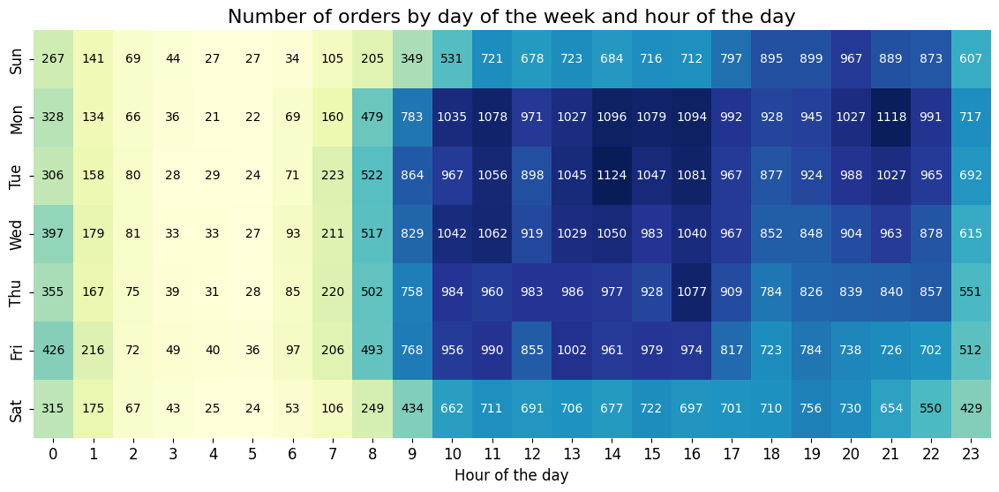

In [28]:
#Visualisation of number of orders by day of the week and hour of the day
import seaborn as sns

fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(df, cmap='YlGnBu', cbar=False)
mean_orders = df.mean().mean()
for i in range(len(df)):
    for j in range(len(df.columns)):
        text_color = 'white' if df.iloc[i, j] > mean_orders else 'black'
        ax.text(j+0.5, i+0.5, int(df.iloc[i, j]),
            color=text_color, fontsize=10, ha="center", va="center")
plt.title("Number of orders by day of the week and hour of the day")
plt.xlabel("Hour of the day")
plt.ylabel("")
plt.show()

1. Most orders placed : 10 AM to 4 PM
2. Least orders placed : 3 AM to 5 AM
3. From Thursday to Sunday, the evening orders begin traction
4. A small dip around 12 PM
5. Saturday is the day with fewer orders


In [32]:
pd.read_sql_query(f"""SELECT * FROM {'customers'} LIMIT {10}""", db_connection)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
5,879864dab9bc3047522c92c82e1212b8,4c93744516667ad3b8f1fb645a3116a4,89254,jaragua do sul,SC
6,fd826e7cf63160e536e0908c76c3f441,addec96d2e059c80c30fe6871d30d177,4534,sao paulo,SP
7,5e274e7a0c3809e14aba7ad5aae0d407,57b2a98a409812fe9618067b6b8ebe4f,35182,timoteo,MG
8,5adf08e34b2e993982a47070956c5c65,1175e95fb47ddff9de6b2b06188f7e0d,81560,curitiba,PR
9,4b7139f34592b3a31687243a302fa75b,9afe194fb833f79e300e37e580171f22,30575,belo horizonte,MG


In [33]:
#Top 10 cities ordering
orders_per_city = """
SELECT 
    customer_city AS customer_city,
    UPPER(customer_city) AS city,
    COUNT(orders.order_id) as city_order_count
FROM 
    customers
    JOIN orders USING (customer_id)
GROUP BY customer_city
ORDER BY city_order_count DESC
LIMIT 10
"""

pd.read_sql_query(orders_per_city, db_connection)

,customer_city,city,city_order_count
0,sao paulo,SAO PAULO,15540
1,rio de janeiro,RIO DE JANEIRO,6882
2,belo horizonte,BELO HORIZONTE,2773
3,brasilia,BRASILIA,2131
4,curitiba,CURITIBA,1521
5,campinas,CAMPINAS,1444
6,porto alegre,PORTO ALEGRE,1379
7,salvador,SALVADOR,1245
8,guarulhos,GUARULHOS,1189
9,sao bernardo do campo,SAO BERNARDO DO CAMPO,938


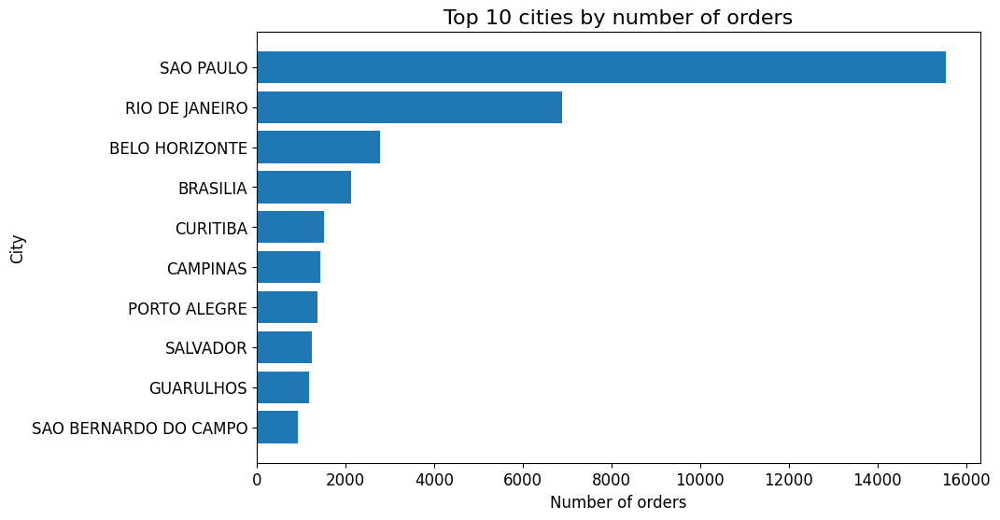

In [34]:
#Visualising top 10 cities
orders_per_city_reversed = f"""
SELECT *
FROM ({orders_per_city})
ORDER BY city_order_count
"""

top_cities = pd.read_sql_query(orders_per_city_reversed, db_connection)

plt.figure(figsize=(10, 6))
plt.barh(top_cities['city'], top_cities['city_order_count'])
plt.xlabel('Number of orders')
plt.ylabel('City')
plt.title('Top 10 cities by number of orders')
plt.show()

As we can see, a lot more orders are placed in São Paulo and Rio de Janerio than in other cities, as they are the largest cities in Brazil.

<br>

# Order prices



In [35]:
# Table order_items, first 4 columns
view_table('order_items', 5).iloc[:, :4]

,order_id,order_item_id,product_id,seller_id
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87


In [36]:
# Table order_items, last 2 columns
view_table('order_items', 5).iloc[:, 5:]

,price,freight_value
0,58.90,13.29
1,239.90,19.93
2,199.00,17.87
3,12.99,12.79
4,199.90,18.14


In [37]:
#Average order price
order_price_stats = """
SELECT
    MIN(order_price) AS min_order_price,
    ROUND(AVG(order_price), 2) AS avg_order_price,
    MAX(order_price) AS max_order_price
FROM (
    SELECT
        orders.order_id,
        SUM(order_items.price + order_items.freight_value) AS order_price
    FROM orders
        JOIN order_items USING (order_id)
    GROUP BY orders.order_id
)
"""

pd.read_sql_query(order_price_stats, db_connection)

,min_order_price,avg_order_price,max_order_price
0,9.59,160.58,13664.08


The most expensive order is 13664.08, almost 100 times the average, stating a probable right-tailed distribution

In [39]:
order_product_and_shipping_costs = """
SELECT
    orders.order_id,
    SUM(price) AS product_cost,
    SUM(freight_value) AS shipping_cost
FROM
    orders
    JOIN order_items USING (order_id)
WHERE order_status = 'delivered'
GROUP BY orders.order_id
"""

df = pd.read_sql_query(order_product_and_shipping_costs, db_connection)
df

,order_id,product_cost,shipping_cost
0,00010242fe8c5a6d1ba2dd792cb16214,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90,18.14
...,...,...,...
96473,fffc94f6ce00a00581880bf54a75a037,299.99,43.41
96474,fffcd46ef2263f404302a634eb57f7eb,350.00,36.53
96475,fffce4705a9662cd70adb13d4a31832d,99.90,16.95
96476,fffe18544ffabc95dfada21779c9644f,55.99,8.72


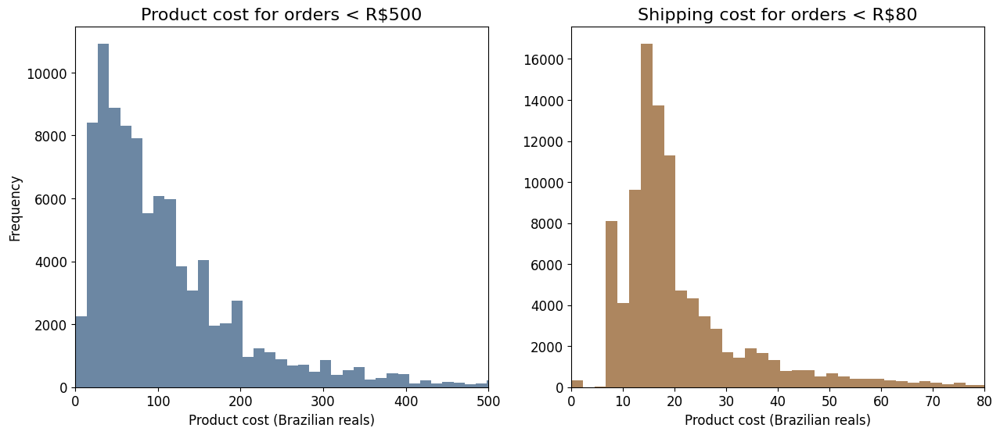

In [40]:
#Visualising using histogram
plt.figure(figsize=(15, 6))
# Histogram for total product cost
plt.subplot(1, 2, 1)
plt.hist(df['product_cost'], bins=1000, color='#6c87a3')
plt.title('Product cost for orders < R$500')
plt.xlabel('Product cost (Brazilian reals)')
plt.ylabel('Frequency')
plt.xlim([0, 500])
# Histogram for total shipping cost
plt.subplot(1, 2, 2)
plt.hist(df['shipping_cost'], bins=800, color='#ad865f')
plt.title('Shipping cost for orders < R$80')
plt.xlabel('Product cost (Brazilian reals)')
plt.xlim([0, 80])
plt.show()

<br>

# Product categories


In [41]:
view_table('products', 5).iloc[:, [0, 1, 5]]

,product_id,product_category_name,product_weight_g
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,225.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1000.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,154.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,371.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,625.0


In [42]:
#Sales of each category
ranked_categories = """
SELECT
    product_category_name_english AS category,
    SUM(price) AS sales,
    RANK() OVER (ORDER BY SUM(price) DESC) AS rank
FROM order_items
    JOIN orders USING (order_id)
    JOIN products USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
WHERE order_status = 'delivered'
GROUP BY product_category_name_english
"""

pd.read_sql_query(ranked_categories, db_connection)

,category,sales,rank
0,health_beauty,1233131.72,1
1,watches_gifts,1166176.98,2
2,bed_bath_table,1023434.76,3
3,sports_leisure,954852.55,4
4,computers_accessories,888724.61,5
...,...,...,...
66,flowers,1110.04,67
67,home_comfort_2,760.27,68
68,cds_dvds_musicals,730.00,69
69,fashion_childrens_clothes,519.95,70


In [43]:
#Top 25% 

category_sales_summary = f"""
WITH RankedCategories AS (
    {ranked_categories}
)
-- Top 18 categories by sales
SELECT
    category,
    sales
FROM RankedCategories
WHERE rank <= 18
-- Other categories, aggregated
UNION ALL
SELECT
    'Other categories' AS category,
    SUM(sales) AS sales
FROM RankedCategories
WHERE rank > 18
"""

df = pd.read_sql_query(category_sales_summary, db_connection)
df

,category,sales
0,health_beauty,1233131.72
1,watches_gifts,1166176.98
2,bed_bath_table,1023434.76
3,sports_leisure,954852.55
4,computers_accessories,888724.61
5,furniture_decor,711927.69
6,housewares,615628.69
7,cool_stuff,610204.10
8,auto,578966.65
9,toys,471286.48


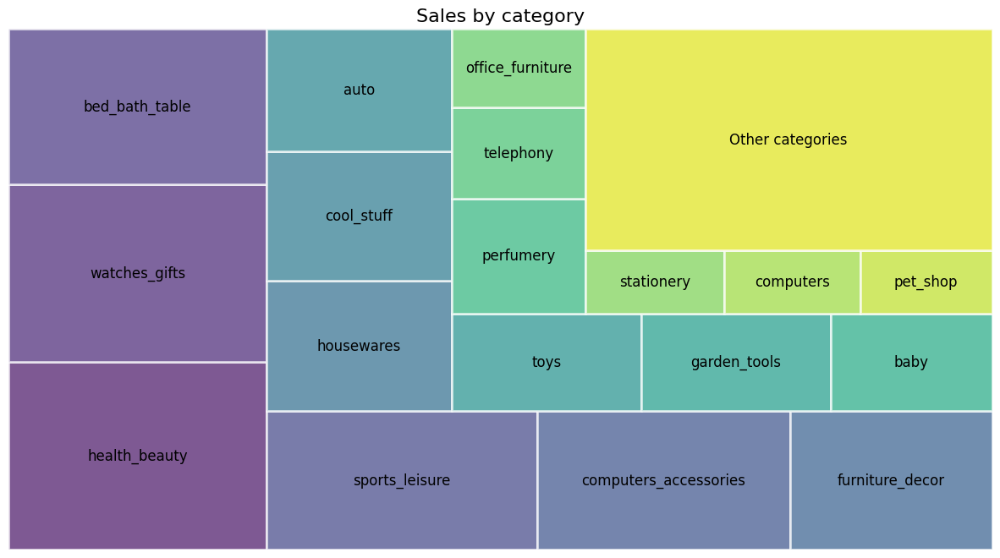

In [44]:
#visualise using tree maps
import squarify 

plt.figure(figsize=(15, 8))
plt.title('Sales by category')
color = sns.color_palette("viridis", len(df))
squarify.plot(sizes=df['sales'], label=df['category'],
              alpha=0.7, color=color, edgecolor="white", linewidth=2)
plt.axis('off')
plt.show()

In [46]:
top_18_categories = tuple(category for category in df['category'] if category != 'Other categories')

ordered_categories = f"""
SELECT
    product_weight_g AS weight,
    product_category_name_english AS category,
    ROW_NUMBER() OVER(PARTITION BY product_category_name_english ORDER BY product_weight_g)
        AS category_row_n,
    COUNT(*) OVER(PARTITION BY product_category_name_english) AS category_count
FROM
    products
    JOIN order_items USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
WHERE
    product_category_name_english IN {top_18_categories}
"""

df = pd.read_sql_query(ordered_categories, db_connection)
df

,weight,category,category_row_n,category_count
0,50.0,auto,1,4235
1,50.0,auto,2,4235
2,50.0,auto,3,4235
3,50.0,auto,4,4235
4,50.0,auto,5,4235
...,...,...,...,...
92419,15267.0,watches_gifts,5987,5991
92420,15267.0,watches_gifts,5988,5991
92421,15267.0,watches_gifts,5989,5991
92422,17175.0,watches_gifts,5990,5991


In [47]:
#calculating median and sorting it
categories_by_median = f"""
WITH OrderedCategories AS (
    {ordered_categories}
)
SELECT category
FROM OrderedCategories
WHERE
    -- Odd number of products: Select the middle row
    (category_count % 2 = 1 AND category_row_n = (category_count + 1) / 2) OR
    -- Even number of products: Select the two middle rows to be averaged
    (category_count % 2 = 0 AND category_row_n IN ((category_count / 2), (category_count / 2 + 1)))
GROUP BY category
ORDER BY AVG(weight)
"""

categories_by_median_df = pd.read_sql_query(categories_by_median, db_connection)
categories_by_median_df

,category
0,telephony
1,computers_accessories
2,watches_gifts
3,health_beauty
4,perfumery
5,baby
6,sports_leisure
7,toys
8,pet_shop
9,auto


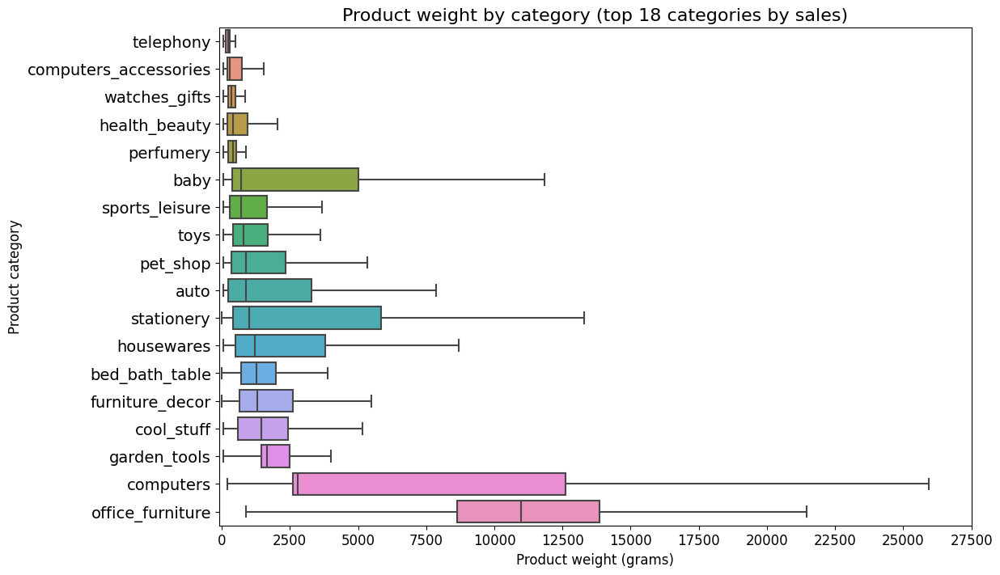

In [48]:
plt.figure(figsize=(12, 8))
order = categories_by_median_df['category'].tolist()
sns.boxplot(x='weight', y='category', data=df, order=order, showfliers=False)
plt.xlabel('Product weight (grams)')
plt.ylabel('Product category')
plt.title('Product weight by category (top 18 categories by sales)')
plt.xlim(-100, 26100)
plt.xticks(ticks=range(0, 30000, 2500))
plt.yticks(fontsize=14)
plt.show()

As we can see at the top of the plot, there are five categories whose items are mostly under 2 Kg: 'telephony', 'computers_accessories', 'watches_gifts', 'health_beauty'. At the bottom, we can see two categories, 'computers' and 'office_furniture', that include much heavier products.

<br>

# Sales prediction



In [50]:
selected_categories = ('health_beauty', 'auto', 'toys', 'electronics', 'fashion_shoes')

In [51]:
#monthly sales of each category
monthly_sales_selected_categories = f"""
SELECT 
    strftime('%Y-%m', order_purchase_timestamp) AS year_month,
    SUM(CASE WHEN product_category_name_english = 'health_beauty' THEN price END) AS health_beauty,
    SUM(CASE WHEN product_category_name_english = 'auto' THEN price END) AS auto,
    SUM(CASE WHEN product_category_name_english = 'toys' THEN price END) AS toys,
    SUM(CASE WHEN product_category_name_english = 'electronics' THEN price END) AS electronics,
    SUM(CASE WHEN product_category_name_english = 'fashion_shoes' THEN price END) AS fashion_shoes
FROM orders
    JOIN order_items USING (order_id)
    JOIN products USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
WHERE order_purchase_timestamp >= '2017-01-01'
    AND product_category_name_english IN {selected_categories}
GROUP BY year_month
"""

df = pd.read_sql_query(monthly_sales_selected_categories, db_connection)
df = df.set_index('year_month')
df

,health_beauty,auto,toys,electronics,fashion_shoes
year_month,,,,,
2017-01,12561.32,5218.53,4814.09,617.00,34.90
2017-02,22838.79,13162.40,9403.34,1218.85,107.05
2017-03,25995.25,14482.07,12429.47,3986.00,1515.00
2017-04,22935.75,15548.17,13039.43,4822.24,1526.50
2017-05,46786.02,18640.03,22626.95,6709.11,1669.54
2017-06,32029.39,31370.69,15476.35,2100.04,1351.20
2017-07,34896.86,14119.74,24511.72,7346.84,1423.01
2017-08,49873.90,20421.11,18126.87,2854.15,1491.69
2017-09,51537.65,14544.67,31399.22,4338.96,1179.60


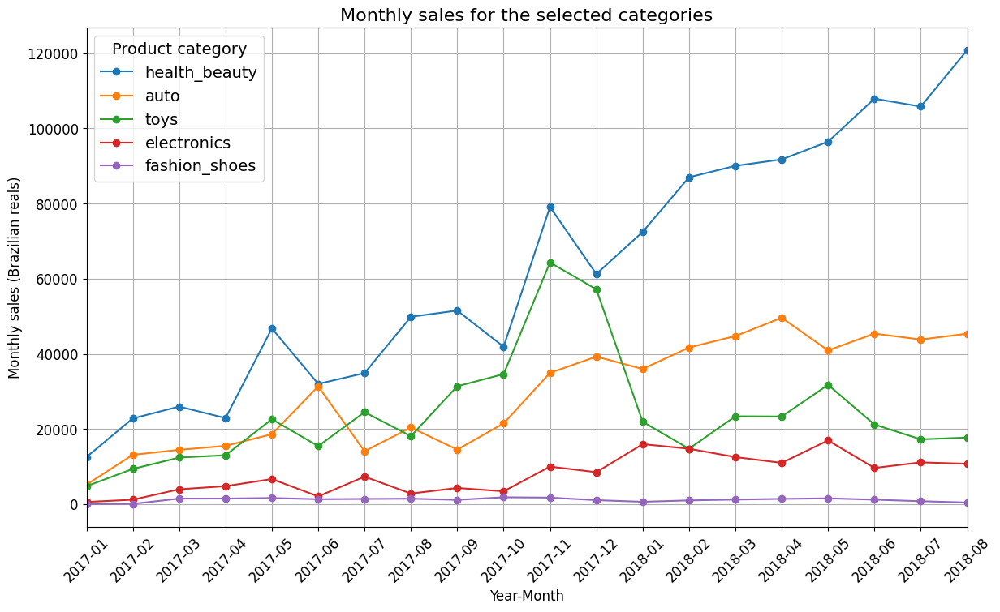

In [52]:
df.index = pd.to_datetime(df.index)
fig, ax = plt.subplots(figsize=(14, 8))
df.plot(ax=ax, marker='o', linestyle='-')
ax.set_xticks(df.index)
ax.set_xticklabels(df.index.strftime('%Y-%m'), rotation=90)
plt.title('Monthly sales for the selected categories')
plt.xlabel('Year-Month')
plt.ylabel('Monthly sales (Brazilian reals)')
plt.xticks(rotation=45)
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.show()

1. 'fashion_shoes' category which has the lowest-performing sales of the five categories and seems stagnant
2. The categories 'electronics' (red), 'auto' (green) and 'health_beauty' (blue), all seem to grow linearly at different rates.  
3. The category 'toys' peaked around the holidays, almost tripling in sales on november and december, but quickly goes back to its baseline after that period.

<br>

## Linear regression



In [53]:
#Predicting next year holiday season sales
daily_sales_per_category = f"""
SELECT
    DATE(order_purchase_timestamp) AS date,
    -- Days since 2017-01-01
    CAST(JULIANDAY(order_purchase_timestamp) - JULIANDAY('2017-01-01') AS INTEGER) AS day,
    product_category_name_english AS category,
    SUM(price) AS sales
FROM
    orders
    JOIN order_items USING (order_id)
    JOIN products USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
WHERE
    order_purchase_timestamp BETWEEN '2017-01-01' AND '2018-08-29'
    AND category IN {selected_categories}
GROUP BY
    day,
    product_category_name_english
"""

pd.read_sql_query(daily_sales_per_category, db_connection)

,date,day,category,sales
0,2017-01-05,4,auto,21.80
1,2017-01-05,4,toys,43.80
2,2017-01-06,5,health_beauty,636.00
3,2017-01-06,5,toys,159.99
4,2017-01-07,6,health_beauty,370.00
...,...,...,...,...
2440,2018-08-27,603,auto,343.38
2441,2018-08-27,603,health_beauty,661.50
2442,2018-08-27,603,toys,257.79
2443,2018-08-28,604,auto,124.00


In [54]:
#Using least squares for the intercept and constant
lm_per_category = f"""
WITH DailySalesPerCategory AS (
    {daily_sales_per_category}
)
SELECT
    category,
    -- Slope
    (COUNT(*) * SUM(day * sales) - SUM(day) * SUM(sales)) / 
        (COUNT(*) * SUM(day * day) - SUM(day) * SUM(day))
        AS slope,
    -- Intercept
    (SUM(sales) -
        ((COUNT(*) * SUM(day * sales) - SUM(day) * SUM(sales)) / 
        (COUNT(*) * SUM(day * day) - SUM(day) * SUM(day))) *
        SUM(day)) / COUNT(*)
        AS intercept
FROM
    DailySalesPerCategory
GROUP BY
    category
"""

df = pd.read_sql_query(lm_per_category, db_connection)
df

,category,slope,intercept
0,auto,2.257831,319.055318
1,electronics,0.614535,105.302974
2,fashion_shoes,0.126815,89.637179
3,health_beauty,5.876734,305.451543
4,toys,0.563910,649.648518


Let's see the regression lines for each category:

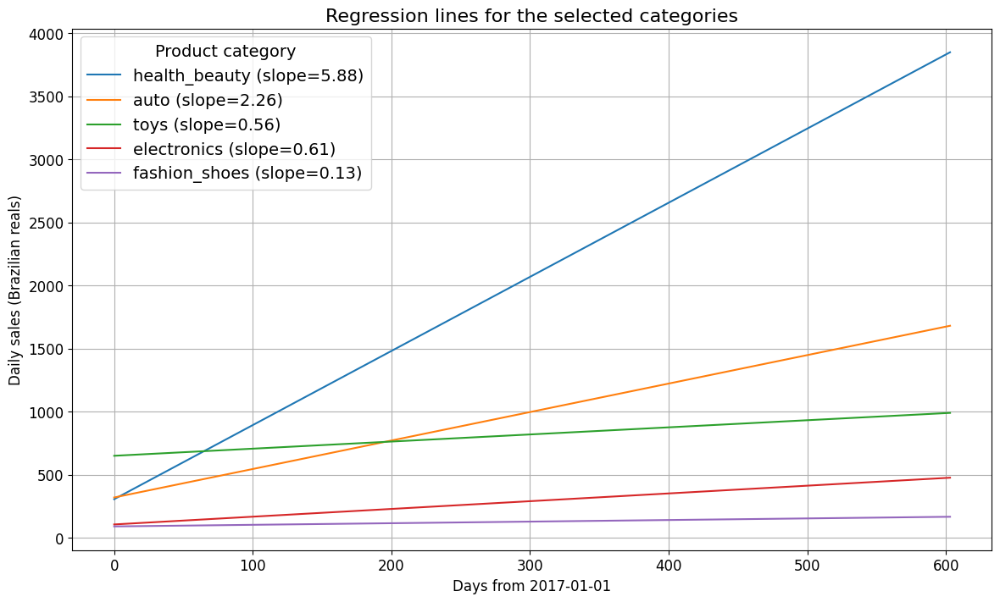

In [55]:
import numpy as np

plt.figure(figsize=(14, 8))
days = np.arange(0, 604)
for category in selected_categories:
    lm = df[df['category'] == category]
    slope = lm['slope'].values[0]
    intercept = lm['intercept'].values[0]
    line = intercept + slope * days
    plt.plot(days, line, label=f'{category} (slope={slope:.2f})')
plt.title('Regression lines for the selected categories')
plt.xlabel('Days from 2017-01-01')
plt.ylabel('Daily sales (Brazilian reals)')
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.show()

Forecasting sales :

In [56]:
forecasted_sales_dec_2018 = f"""
WITH DailySalesPerCategory AS (
    {daily_sales_per_category}
),
LmPerCategory AS (
    {lm_per_category}
),
ForecastedSales AS (
    SELECT
        DATE(date, '+1 year') AS date,
        category,
        -- Increase in predicted sales * sales 1 year ago
        (intercept + slope * (day + CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-12-31') AS INTEGER)))
            / (intercept + slope * day) * sales
            AS forecasted_sales
    FROM DailySalesPerCategory
        JOIN LmPerCategory USING (category)
    -- Filter for days of December 2018
    WHERE day + CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-12-31') AS INTEGER)
        BETWEEN CAST(JULIANDAY('2018-12-01') - JULIANDAY('2017-01-01') AS INTEGER)
        AND CAST(JULIANDAY('2018-12-31') - JULIANDAY('2017-01-01') AS INTEGER)
)
SELECT
    CAST(strftime('%d', date) AS INTEGER) AS december_2018_day,
    category,
    -- 5-day moving average
    AVG(forecasted_sales)
        OVER (PARTITION BY category ORDER BY date ROWS BETWEEN 2 PRECEDING AND 2 FOLLOWING)
        AS moving_avg_sales
FROM ForecastedSales
"""

forecast_2018_12_df = pd.read_sql_query(forecasted_sales_dec_2018, db_connection)
forecast_2018_12_df

,december_2018_day,category,moving_avg_sales
0,1,auto,2438.257278
1,2,auto,2957.096207
2,3,auto,2612.112277
3,4,auto,3034.655653
4,5,auto,2919.956942
...,...,...,...
126,27,toys,1247.841517
127,28,toys,857.343323
128,29,toys,585.209963
129,30,toys,621.773116


In the next plot, we can see the predicted sales for december 2018 for each category:

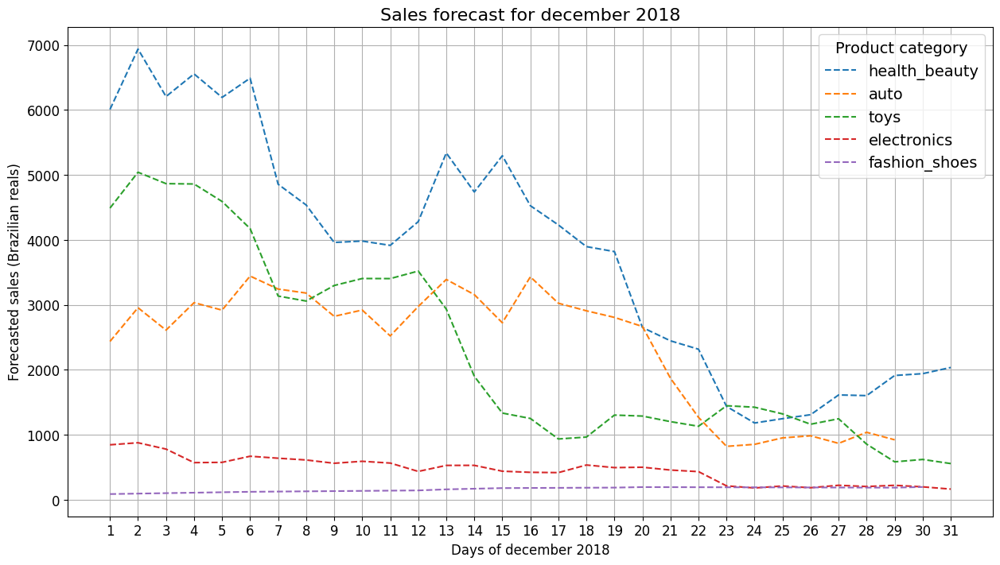

In [57]:
plt.figure(figsize=(15, 8))
for category in selected_categories:
    category_forecast = forecast_2018_12_df[forecast_2018_12_df['category'] == category]
    plt.plot(category_forecast['december_2018_day'], category_forecast['moving_avg_sales'], '--', label=category)
plt.title('Sales forecast for december 2018')
plt.xlabel('Days of december 2018')
plt.ylabel('Forecasted sales (Brazilian reals)')
plt.legend(title='Product category', title_fontsize=14, fontsize=14)
plt.grid(True)
plt.xticks(range(1, 32))
plt.show()

This model predicts that 'health_beauty' will be the highest selling category of the five and its sales will slowly go down until Christmas. 'toys' will have strong sales for the first two weeks but decline sharply after that. 'auto' sales remain stable for the first 3 weeks, but they'll go down afterward. 'electronics' follows a similar trend but *fashion_shoes* sales seem to be independent of the holiday trends, increasing slightly at the end of the month.

<br>

# Order delivery

As we saw at the start of this notebook, the **orders** table contains various timestamps:
- *order_purchase_timestamp*: The order is placed by the customer.
- *order_approved_at*: The order is approved by Olist.
- *order_delivered_carrier_date*: The order is handed to the shipping company.
- *order_delivered_customer_date*: The customer receives the order.
- *order_estimated_delivery_date*: Delivery date estimation.

Each of these timestamps marks a change in the order shipping process. Let's query the data necessary to visualize the average time for each stage of the order process, for each of the top 10 cities with the most orders, which we saw earlier:

In [58]:
#Average time for each stage of order

order_stage_times_top_10_citites = f"""
SELECT 
    UPPER(customer_city)
        AS city,
    AVG(JULIANDAY(order_approved_at) - JULIANDAY(order_purchase_timestamp))
        AS approved,
    AVG(JULIANDAY(order_delivered_carrier_date) - JULIANDAY(order_approved_at))
        AS delivered_to_carrier,
    AVG(JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_delivered_carrier_date))
        AS delivered_to_customer,
    AVG(JULIANDAY(order_estimated_delivery_date) - JULIANDAY(order_delivered_customer_date))
        AS estimated_delivery
FROM orders
    JOIN customers USING (customer_id)
WHERE  customer_city IN {tuple(top_cities['customer_city'])}
GROUP BY  customer_city
ORDER BY approved + delivered_to_carrier + delivered_to_customer DESC
"""

df = pd.read_sql_query(order_stage_times_top_10_citites, db_connection)
df = df.set_index('city')
df

,approved,delivered_to_carrier,delivered_to_customer,estimated_delivery
city,,,,
SALVADOR,0.498863,2.700868,16.160566,8.755085
PORTO ALEGRE,0.420697,2.809786,12.786769,11.091915
RIO DE JANEIRO,0.383342,2.979133,11.409813,12.504991
BRASILIA,0.432585,2.762064,9.805472,11.333709
BELO HORIZONTE,0.378608,2.848813,7.900486,11.901479
CURITIBA,0.453929,2.690824,7.316206,12.732135
CAMPINAS,0.420262,2.784653,6.611740,8.821432
SAO BERNARDO DO CAMPO,0.349693,2.702651,5.045101,9.799631
SAO PAULO,0.385928,2.726784,4.961921,10.027349


Let's visualize the dataframe as a stacked bar plot:

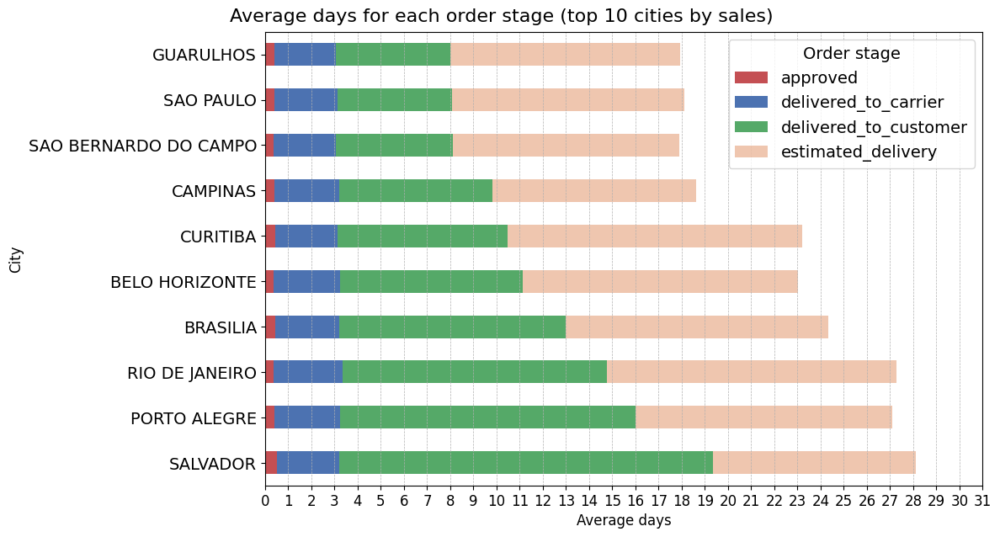

In [59]:
fig, ax = plt.subplots(figsize=(11, 7))
df.plot(kind='barh', stacked=True, color=['#c44f53', '#4c72b1', '#55a968', '#dd845275'], ax=ax)
ax.set_xlabel('Average days')
ax.set_ylabel('City')
fig.suptitle('Average days for each order stage (top 10 cities by sales)', fontsize=16, x=0.38, y=0.92)
ax.grid(True, linestyle='--', linewidth=0.5, axis='x')
max_bar_length = int(df.sum(axis=1).max())
ax.set_xticks(range(0, max_bar_length + 4))
ax.tick_params(axis='y', labelsize=14)
plt.legend(title='Order stage', title_fontsize=14, fontsize=14)
plt.show()

In [60]:
daily_avg_shipping_time = """
SELECT
    DATE(order_purchase_timestamp) AS purchase_date,
    AVG(JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_purchase_timestamp))
        AS avg_delivery_time
FROM orders
WHERE order_purchase_timestamp >= '2017-06-01' AND order_purchase_timestamp <= '2018-06-30'
GROUP BY DATE(order_purchase_timestamp)
"""

df = pd.read_sql_query(daily_avg_shipping_time, db_connection)
df

,purchase_date,avg_delivery_time
0,2017-06-01,11.238623
1,2017-06-02,12.079623
2,2017-06-03,14.255051
3,2017-06-04,12.064359
4,2017-06-05,11.101563
...,...,...
389,2018-06-25,7.280438
390,2018-06-26,8.173340
391,2018-06-27,8.854751
392,2018-06-28,8.601704


Let's plot the time series, with a red line showing the global average shipping time during the period:

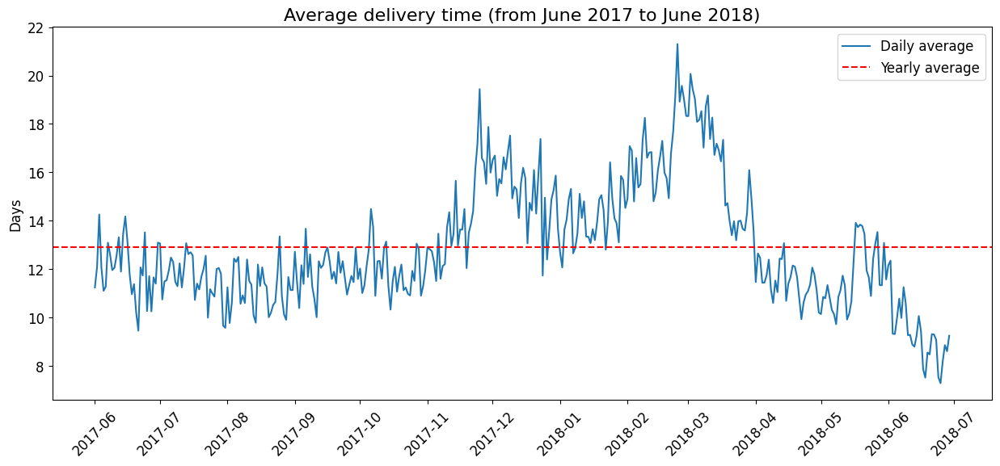

In [61]:
plt.figure(figsize=(15, 6))
plt.plot(pd.to_datetime(df['purchase_date']), df['avg_delivery_time'], label='Daily average')
plt.axhline(y=df['avg_delivery_time'].mean(), color='r', linestyle='--', label='Yearly average')
plt.ylabel('Days')
plt.title('Average delivery time (from June 2017 to June 2018)')
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.xticks(rotation=45)
plt.legend()
plt.show()

As we can see, there are two periods where shipping times are significantly higher than average: December 2017 and February-March 2018. The delays on december are probably caused by the busy holiday season, but the delays February-March could be due to the some external factor. So there are seasonal changes afftecting deliveries.

# Order reviews



In [62]:
view_table('order_reviews', 5).iloc[:, [1, 2, 4]]

,order_id,review_score,review_comment_message
0,73fc7af87114b39712e6da79b0a377eb,4,None
1,a548910a1c6147796b98fdf73dbeba33,5,None
2,f9e4b658b201a9f2ecdecbb34bed034b,5,None
3,658677c97b385a9be170737859d3511b,5,Recebi bem antes do prazo estipulado.
4,8e6bfb81e283fa7e4f11123a3fb894f1,5,Parabéns lojas lannister adorei comprar pela I...


In [64]:
#Orders per review score
review_score_count = """
SELECT
    review_score,
    COUNT(*) AS count
FROM order_reviews
GROUP BY review_score
"""
df = pd.read_sql_query(review_score_count, db_connection)
df

,review_score,count
0,1,11424
1,2,3151
2,3,8179
3,4,19142
4,5,57328


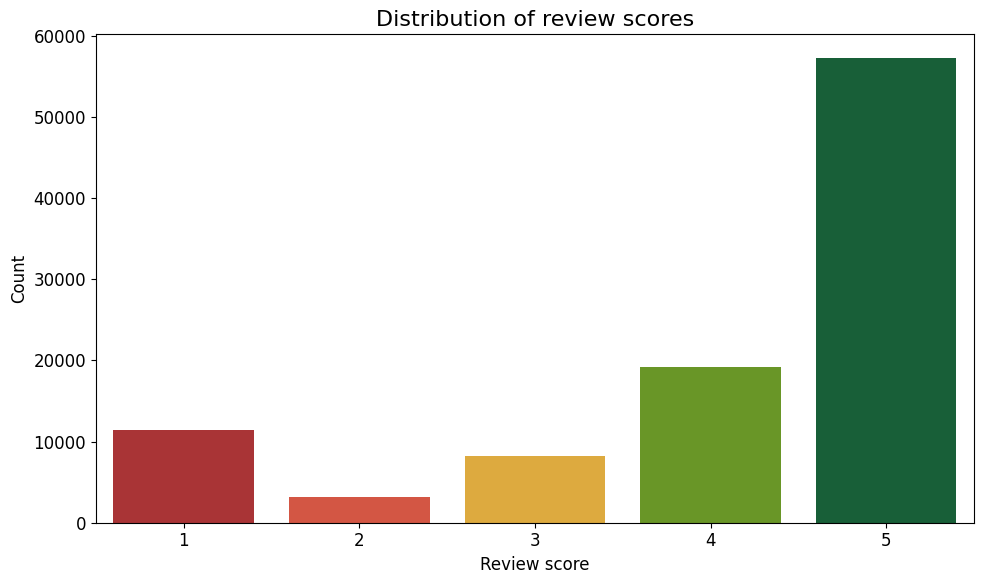

In [65]:
plt.figure(figsize=(10,6))
colors = ['#BC2023', '#EB442C', '#F8B324', '#6da814', '#0C6B37']
sns.barplot(x='review_score', y='count', data=df, hue='review_score', palette=colors, dodge=False)
plt.title('Distribution of review scores')
plt.xlabel('Review score')
plt.ylabel('Count')
plt.legend().remove()
plt.tight_layout()
plt.show()


We can see that most review scores are very positive, but there's also a fair number of unsatisfied customers.

In [66]:
#Finding the reason for poor reviews
negative_comments = """
SELECT GROUP_CONCAT(review_comment_message, ' ') AS comments
FROM order_reviews
WHERE review_score IN (1,2)
"""

negative_comments_df = pd.read_sql(negative_comments, db_connection)['comments'][0]
negative_comments_df[:150]

'GOSTARIA DE SABER O QUE HOUVE, SEMPRE RECEBI E ESSA COMPRA AGORA ME DECPCIONOU Péssimo Não gostei ! Comprei gato por lebre Sempre compro pela Internet'

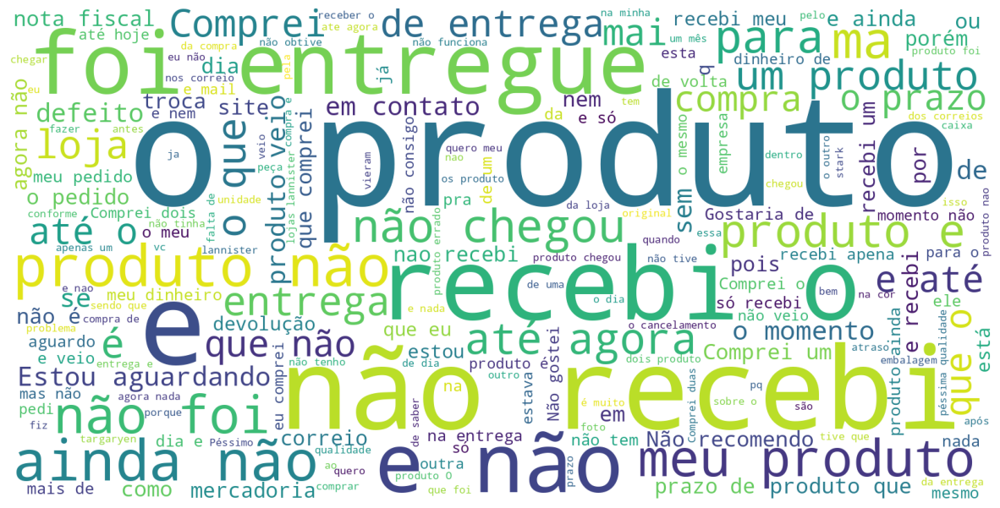

In [67]:
from wordcloud import WordCloud

wordcloud = WordCloud(width=1600, height=800, background_color='white').generate(negative_comments_df)
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

Shipping delays and dissatisfaction to the product quality are the main reasons for poor reviews

<br>

# Customer lifetime value


In [68]:
view_table('order_payments', 5)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


For calculating CLV, you need:
- Purchase Frequency (PF), the number of orders a client placed.
- Average Order Value (AOV), the sum of payments divided by the number of orders.
- Average Customer Lifespan (ACL), the number of weeks from the first to the last order, with a minimum value of 1.

In [69]:
clv = """
WITH CustomerData AS (
    SELECT
        customer_unique_id,
        customer_zip_code_prefix AS zip_code_prefix,
        COUNT(DISTINCT orders.order_id) AS order_count,
        SUM(payment_value) AS total_payment,
        JULIANDAY(MIN(order_purchase_timestamp)) AS first_order_day,
        JULIANDAY(MAX(order_purchase_timestamp)) AS last_order_day
    FROM customers
        JOIN orders USING (customer_id)
        JOIN order_payments USING (order_id)
    GROUP BY customer_unique_id
)
SELECT
    customer_unique_id,
    zip_code_prefix,
    order_count AS PF,
    total_payment / order_count AS AOV,
    CASE
        WHEN (last_order_day - first_order_day) < 7 THEN
            1
        ELSE
            (last_order_day - first_order_day) / 7
        END AS ACL
FROM CustomerData
"""

pd.read_sql(clv, db_connection)

,customer_unique_id,zip_code_prefix,PF,AOV,ACL
0,0000366f3b9a7992bf8c76cfdf3221e2,7787,1,141.90,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,6053,1,27.19,1.0
2,0000f46a3911fa3c0805444483337064,88115,1,86.22,1.0
3,0000f6ccb0745a6a4b88665a16c9f078,66812,1,43.62,1.0
4,0004aac84e0df4da2b147fca70cf8255,18040,1,196.89,1.0
...,...,...,...,...,...
96090,fffcf5a5ff07b0908bd4e2dbc735a684,55250,1,2067.42,1.0
96091,fffea47cd6d3cc0a88bd621562a9d061,44054,1,84.58,1.0
96092,ffff371b4d645b6ecea244b27531430a,78552,1,112.46,1.0
96093,ffff5962728ec6157033ef9805bacc48,29460,1,133.69,1.0


In [70]:
view_table('geolocation', 5)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


Calculate CLV

In [71]:
avg_clv_per_zip_prefix = f"""
WITH CLV AS (
    {clv}
)
SELECT
    zip_code_prefix AS zip_prefix,
    AVG(PF * AOV * ACL) AS avg_CLV,
    COUNT(customer_unique_id) AS customer_count,
    geolocation_lat AS latitude,
    geolocation_lng AS longitude
FROM CLV
    JOIN geolocation ON CLV.zip_code_prefix = geolocation.geolocation_zip_code_prefix
GROUP BY zip_code_prefix
"""

df = pd.read_sql(avg_clv_per_zip_prefix, db_connection)
df

,zip_prefix,avg_CLV,customer_count,latitude,longitude
0,1003,98.970000,17,-23.549032,-46.635313
1,1004,99.055000,44,-23.550116,-46.635122
2,1005,1082.762826,125,-23.549819,-46.635606
3,1006,434.025000,18,-23.550524,-46.636694
4,1007,126.387500,104,-23.550393,-46.637302
...,...,...,...,...,...
14821,99960,97.315000,10,-27.953797,-52.029641
14822,99965,113.795000,12,-28.173892,-52.038447
14823,99970,252.740000,21,-28.345143,-51.876926
14824,99980,111.385000,52,-28.389218,-51.846012


In [72]:
import folium

map = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
for i, zip_prefix in df.iterrows():
    folium.CircleMarker(
        location=[zip_prefix['latitude'], zip_prefix['longitude']],
        radius=0.1*np.sqrt(zip_prefix['customer_count']),
        color=None,
        fill_color='#85001d',
        fill_opacity=0.1+0.1*np.sqrt(zip_prefix['avg_CLV']/df['avg_CLV'].max()),
        popup=(
            f"<b>Zip Code Prefix:</b> {int(zip_prefix['zip_prefix'])}<br>"
            f"<b>Average CLV:</b> {int(zip_prefix['avg_CLV'])}<br>"
            f"<b>Customers:</b> {int(zip_prefix['customer_count'])}"
        )
    ).add_to(map)
map

Most of the CLV is centered around the most popular areas of Brazil

<br>

# Product affinity



In [73]:
#What products are bought together
min_orders = 5

most_ordered_products = f"""
SELECT
    products.product_id,
    product_category_name_english AS category,
    COUNT(order_id) AS orders_count
FROM order_items
    JOIN products USING (product_id)
    JOIN product_category_name_translation AS tr
        ON products.product_category_name = tr.product_category_name
GROUP BY products.product_id
    HAVING COUNT(order_id) > {min_orders}
"""

most_ordered_products_df = pd.read_sql(most_ordered_products, db_connection)
most_ordered_products_df

,product_id,category,orders_count
0,001795ec6f1b187d37335e1c4704762e,consoles_games,9
1,001b72dfd63e9833e8c02742adf472e3,furniture_decor,14
2,00210e41887c2a8ef9f791ebc780cc36,health_beauty,7
3,002159fe700ed3521f46cfcf6e941c76,fashion_shoes,8
4,00250175f79f584c14ab5cecd80553cd,housewares,11
...,...,...,...
3798,ffb97eb64c6fe1baada2410288c04457,perfumery,8
3799,ffc0b406806006602c5853b00ab5f7fd,christmas_supplies,6
3800,ffc9caf33e2d1e9f44e3e06da19085f7,health_beauty,27
3801,ffd4bf4306745865e5692f69bd237893,fashion_bags_accessories,8


In [74]:
most_ordered_product_ids = tuple(most_ordered_products_df['product_id'])

products_often_ordered_together = f"""
SELECT
    oi1.product_id AS product_id1,
    oi2.product_id AS product_id2,
    COUNT(DISTINCT oi1.order_id) AS common_orders_count
FROM order_items AS oi1
    JOIN order_items AS oi2
        ON oi1.order_id = oi2.order_id -- Same order
        AND oi1.product_id < oi2.product_id -- Avoid permutations
WHERE
    oi1.product_id IN {most_ordered_product_ids} AND
    oi2.product_id IN {most_ordered_product_ids}
GROUP BY
    oi1.product_id,
    oi2.product_id
    HAVING COUNT(DISTINCT oi1.order_id) > {min_orders}
"""

products_often_ordered_together_df = pd.read_sql(products_often_ordered_together, db_connection)
products_often_ordered_together_df

,product_id1,product_id2,common_orders_count
0,060cb19345d90064d1015407193c233d,98d61056e0568ba048e5d78038790e77,6
1,0bcc3eeca39e1064258aa1e932269894,422879e10f46682990de24d770e7f83d,6
2,0d85c435fd60b277ffb9e9b0f88f927a,ee57070aa3b24a06fdd0e02efd2d757d,6
3,18486698933fbb64af6c0a255f7dd64c,dbb67791e405873b259e4656bf971246,7
4,35afc973633aaeb6b877ff57b2793310,99a4788cb24856965c36a24e339b6058,29
5,368c6c730842d78016ad823897a372db,53759a2ecddad2bb87a079a1f1519f73,8
6,36f60d45225e60c7da4558b070ce4b60,3f14d740544f37ece8a9e7bc8349797e,12
7,36f60d45225e60c7da4558b070ce4b60,e53e557d5a159f5aa2c5e995dfdf244b,34
8,389d119b48cf3043d311335e499d9c6b,422879e10f46682990de24d770e7f83d,11
9,389d119b48cf3043d311335e499d9c6b,53759a2ecddad2bb87a079a1f1519f73,9


With these two sets of data, we can build the graph of products frequently bought together:

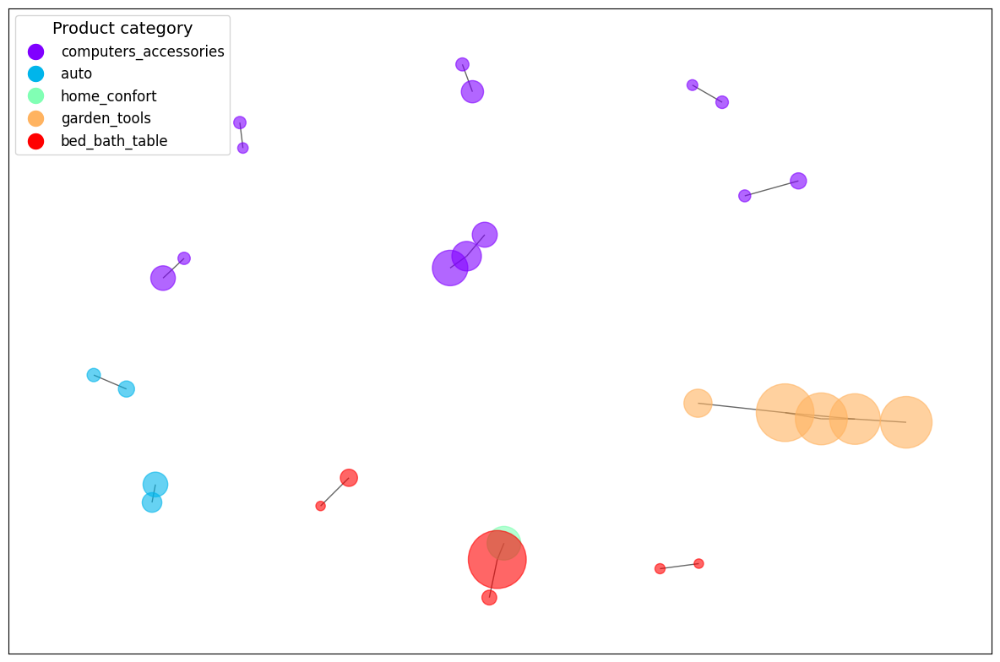

In [75]:
import networkx as nx

G = nx.Graph()
# Add nodes to the graph
for _, product in most_ordered_products_df.iterrows():
    G.add_node(product['product_id'], category=product['category'], orders_count=product['orders_count'])
# Add edges to the graph
for _, pair in products_often_ordered_together_df.iterrows():
    G.add_edge(pair['product_id1'], pair['product_id2'], weight=pair['common_orders_count'])
# Remove nodes with no edges
G.remove_nodes_from(list(nx.isolates(G)))
# Assign colors to categories
categories = list(set(nx.get_node_attributes(G, 'category').values()))
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))
category_colors = dict(zip(categories, colors))
# Draw the graph
plt.figure(figsize=(12, 8))
position = nx.spring_layout(G, k=0.5, iterations=50)
node_sizes = [G.nodes[n]['orders_count'] * 5 for n in G.nodes]
node_colors = [category_colors[G.nodes[n]['category']] for n in G.nodes]
nx.draw_networkx(G, position, node_color=node_colors, node_size=node_sizes, alpha=0.6, with_labels=False)
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=category, markerfacecolor=color, markersize=15)
                   for category, color in category_colors.items()]
plt.legend(handles=legend_elements, title="Product category", loc='upper left', title_fontsize=14)
plt.tight_layout()
plt.show()

In the graph each circle represents a product and its color indicates the product category it belongs to. A line between two products indicates that they are often bought together as part of the same order. The circle's size indicates product importance, how many orders in the whole dataset contain this product.

<br>

# Sellers



In [76]:
view_table('sellers', 5)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


Distribution of sellers by order size.

In [79]:
bucketed_sellers = """
SELECT
    seller_id,
    CASE 
        WHEN COUNT(order_id) BETWEEN 1 AND 9 THEN '1-9 orders'
        WHEN COUNT(order_id) BETWEEN 10 AND 99 THEN '10-99 orders'
        WHEN COUNT(order_id) BETWEEN 100 AND 999 THEN '100-999 orders'
        ELSE '1000+ orders'
    END AS bucket
FROM order_items
GROUP BY seller_id
"""

pd.read_sql_query(bucketed_sellers, db_connection).head(5)

,seller_id,bucket
0,0015a82c2db000af6aaaf3ae2ecb0532,1-9 orders
1,001cca7ae9ae17fb1caed9dfb1094831,100-999 orders
2,001e6ad469a905060d959994f1b41e4f,1-9 orders
3,002100f778ceb8431b7a1020ff7ab48f,10-99 orders
4,003554e2dce176b5555353e4f3555ac8,1-9 orders


In [80]:
sellers_per_bucket = f"""
WITH BucketedSellers AS (
    {bucketed_sellers}
)
SELECT 
    bucket,
    COUNT(seller_id) AS seller_count
FROM BucketedSellers
GROUP BY bucket
"""

seller_buckets = pd.read_sql_query(sellers_per_bucket, db_connection)
seller_buckets

,bucket,seller_count
0,1-9 orders,1714
1,10-99 orders,1142
2,100-999 orders,226
3,1000+ orders,13


Let's visualize the dataframe:

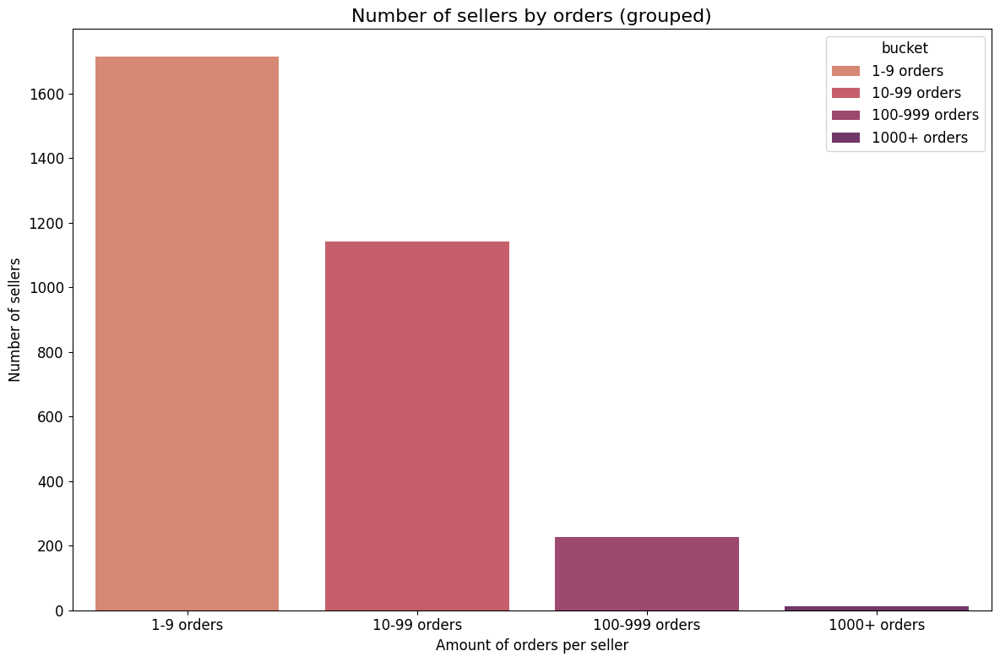

In [81]:
plt.figure(figsize=(12, 8))
sns.barplot(x='bucket', y='seller_count', data=seller_buckets, hue='bucket', palette='flare', dodge=False)
plt.title('Number of sellers by orders (grouped)')
plt.xlabel('Amount of orders per seller')
plt.ylabel('Number of sellers')
plt.tight_layout()
plt.show()

We can verify most sellers are small, with very few having more than 1000 orders.

In [82]:
#Seller shipping times
seller_shipping_times = f"""
WITH BucketedSellers AS (
    {bucketed_sellers}
)
SELECT
    bucket,
    BucketedSellers.seller_id,
    JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_purchase_timestamp)
        AS delivery_time
FROM orders
    JOIN order_items USING (order_id)
    JOIN BucketedSellers USING (seller_id)
WHERE order_status = 'delivered'
"""

df = pd.read_sql_query(seller_shipping_times, db_connection)
df

,bucket,seller_id,delivery_time
0,10-99 orders,3504c0cb71d7fa48d967e0e4c94d59d9,8.436574
1,100-999 orders,289cdb325fb7e7f891c38608bf9e0962,13.782037
2,1000+ orders,4869f7a5dfa277a7dca6462dcf3b52b2,9.394213
3,100-999 orders,66922902710d126a0e7d26b0e3805106,13.208750
4,100-999 orders,2c9e548be18521d1c43cde1c582c6de8,2.873877
...,...,...,...
110192,10-99 orders,1f9ab4708f3056ede07124aad39a2554,22.193727
110193,10-99 orders,d50d79cb34e38265a8649c383dcffd48,24.859421
110194,100-999 orders,a1043bafd471dff536d0c462352beb48,17.086424
110195,100-999 orders,a1043bafd471dff536d0c462352beb48,17.086424


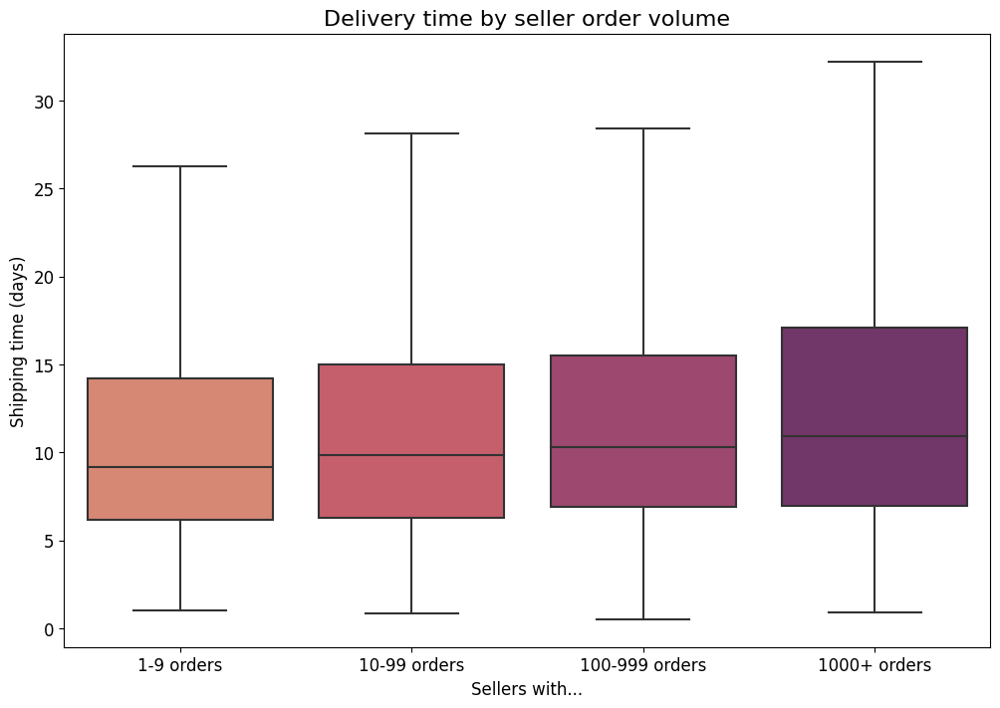

In [83]:
plt.figure(figsize=(12, 8))
palette = sns.color_palette('flare', len(seller_buckets['bucket']))
sns.boxplot(x='bucket', y='delivery_time', data=df, order=seller_buckets['bucket'], showfliers=False,
            hue='bucket', palette=palette[1:]+palette[:1], dodge=False)
plt.title('Delivery time by seller order volume')
plt.xlabel('Sellers with...')
plt.ylabel('Shipping time (days)')
plt.legend().remove() 
plt.show()

The larger the seller is, the longer deliveries tend to take. Maybe the process of delivery of goods to transport is a problem here

<br>

# Lead conversion

In [84]:
view_table('leads_qualified', 5)

,mql_id,first_contact_date,landing_page_id,origin
0,dac32acd4db4c29c230538b72f8dd87d,2018-02-01,88740e65d5d6b056e0cda098e1ea6313,social
1,8c18d1de7f67e60dbd64e3c07d7e9d5d,2017-10-20,007f9098284a86ee80ddeb25d53e0af8,paid_search
2,b4bc852d233dfefc5131f593b538befa,2018-03-22,a7982125ff7aa3b2054c6e44f9d28522,organic_search
3,6be030b81c75970747525b843c1ef4f8,2018-01-22,d45d558f0daeecf3cccdffe3c59684aa,email
4,5420aad7fec3549a85876ba1c529bd84,2018-02-21,b48ec5f3b04e9068441002a19df93c6c,organic_search


In [85]:
view_table('leads_closed', 5).iloc[:, [0,3,4,5]]

,mql_id,sr_id,won_date,business_segment
0,5420aad7fec3549a85876ba1c529bd84,4ef15afb4b2723d8f3d81e51ec7afefe,2018-02-26 19:58:54,pet
1,a555fb36b9368110ede0f043dfc3b9a0,d3d1e91a157ea7f90548eef82f1955e3,2018-05-08 20:17:59,car_accessories
2,327174d3648a2d047e8940d7d15204ca,6565aa9ce3178a5caf6171827af3a9ba,2018-06-05 17:27:23,home_appliances
3,f5fee8f7da74f4887f5bcae2bafb6dd6,d3d1e91a157ea7f90548eef82f1955e3,2018-01-17 13:51:03,food_drink
4,ffe640179b554e295c167a2f6be528e0,d3d1e91a157ea7f90548eef82f1955e3,2018-07-03 20:17:45,home_appliances


In [86]:
lead_conversion = """
SELECT 
    COALESCE(origin, 'unknown') AS origin,
    COUNT(DISTINCT leads_qualified.mql_id) AS qualified_leads,
    COUNT(DISTINCT leads_closed.mql_id) AS closed_leads,
    COUNT(DISTINCT leads_closed.mql_id) * 100.0 / COUNT(DISTINCT leads_qualified.mql_id)
        AS conversion_rate
FROM leads_qualified
    LEFT JOIN leads_closed USING (mql_id)
GROUP BY COALESCE(origin, 'unknown')
ORDER BY COUNT(leads_qualified.mql_id) DESC
"""

df = pd.read_sql_query(lead_conversion, db_connection)
df

,origin,qualified_leads,closed_leads,conversion_rate
0,organic_search,2296,271,11.803136
1,paid_search,1586,195,12.295082
2,social,1350,75,5.555556
3,unknown,1159,193,16.652286
4,direct_traffic,499,56,11.222445
5,email,493,15,3.042596
6,referral,284,24,8.450704
7,other,150,4,2.666667
8,display,118,6,5.084746
9,other_publicities,65,3,4.615385


Let's visualize the data using a grouped bar plot:

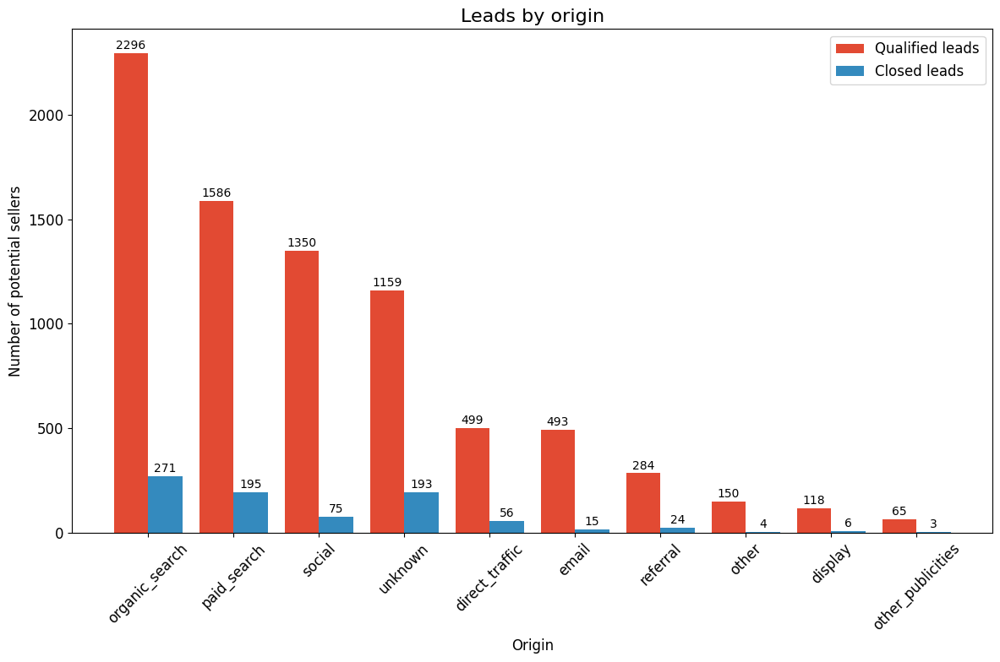

In [87]:
plt.figure(figsize=(12, 8))
bar_width = 0.4
r1 = range(len(df))
r2 = [x + bar_width for x in r1]
plt.bar(r1, df['qualified_leads'], color='#e24a33', width=bar_width, label='Qualified leads')
plt.bar(r2, df['closed_leads'], color='#348abe', width=bar_width, label='Closed leads')
for i, v in enumerate(df['qualified_leads']):
    plt.text(i, v + 20, str(v), ha='center', fontsize=10)
for i, v in enumerate(df['closed_leads']):
    plt.text(i + bar_width, v + 20, str(v), ha='center', fontsize=10)
plt.xlabel('Origin')
plt.ylabel('Number of potential sellers')
plt.title('Leads by origin')
plt.xticks([r + bar_width / 2 for r in range(len(df))], df['origin'],
           rotation=45, color='black', fontsize=12)
plt.legend(fontsize=12)
plt.tight_layout()
plt.show()

As we can see, only a small proportion of qualified leads end up becoming Olist sellers.

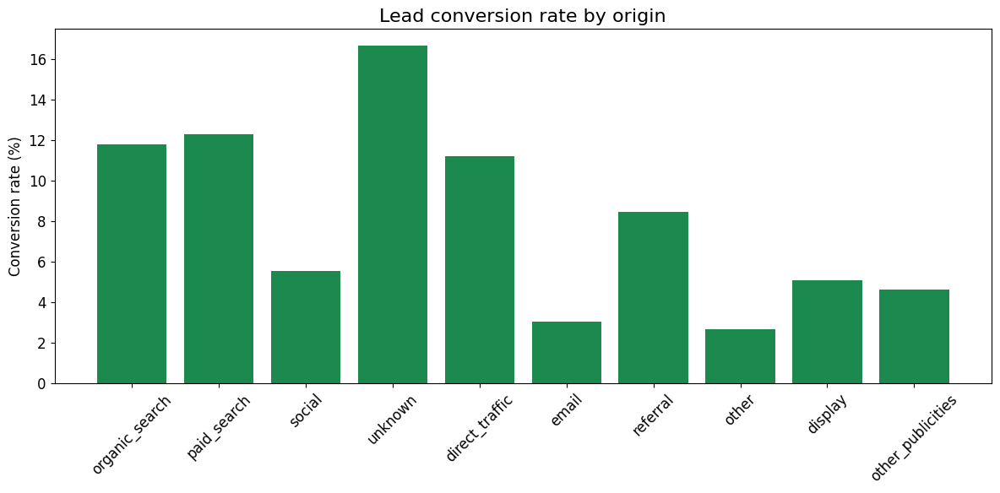

In [88]:
plt.figure(figsize=(12, 6))
plt.bar(df['origin'], df['conversion_rate'], color='#1c8a4f')
plt.ylabel('Conversion rate (%)')
plt.title('Lead conversion rate by origin')
plt.xticks(rotation=45, color='black', fontsize=12)
plt.tight_layout()
plt.show()

In the plot, we can see the proportion of leads that become Olist sellers by channel of origin, in the same order as the previous grouped bar plot.

We can see that, while 'paid_search', 'organic_search' and 'direct_traffic' have the best conversion rate.

<br>

<br>